# Trabajo Preparación, visualizacion de Datos y Machine learning  con Python<a class="tocSkip">
## Machine Learning <a class="tocSkip">
## Facultad TIC Universidad Pontificia Bolivariana <a class="tocSkip">

**Estudiante:** Estebana Orozco

**ID:** 000322731

**Email:** estebana.orozco@upb.edu.co

**Fecha de Entrega: 22 de Octubre de 2020**
 
Docente: [Jose R. Zapata](https://joserzapata.github.io)
- https://joserzapata.github.io
- https://twitter.com/joserzapata
- https://www.linkedin.com/in/jose-ricardo-zapata-gonzalez/       


# Definir el Problema a Resolver

Desde 2008, los huéspedes y los anfitriones han utilizado Airbnb para viajar de una manera más única y personalizada. Como parte de la iniciativa Airbnb Inside, este conjunto de datos describe la actividad del listado de casas de familia en Boston, MA. 

**¿Qué podemos aprender sobre los alquileres de AirBnB si intentamos modelar su precio?**

## Variables
- El dataset cuenta con 3585 registros y 95 columnas, de las cuáles 18 son de tipo flotante, 15 de tipo entero y 62 de tipo objeto (String).
- La variable objetivo será price, ya que deseamos crear un modelo que permita predecir el precio de alquiler de la casa, con base en las diferentes características que tiene el dataset.

## Describir los datos de entrada y salida
- Cantidad de Variables
- Tipo de Variables
- Significado de cada Variable

# Importar Librerias

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder


In [2]:
import scipy.stats as stats
from scipy.stats import chi2_contingency

# Cargar Datasets

In [3]:
Airbnb_dataraw = pd.read_csv("./listings_airbnb.csv")

In [4]:
Airbnb_dataraw.head()

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month
0,12147973,https://www.airbnb.com/rooms/12147973,20160906204935,2016-09-07,Sunny Bungalow in the City,"Cozy, sunny, family home. Master bedroom high...",The house has an open and cozy feel at the sam...,"Cozy, sunny, family home. Master bedroom high...",none,"Roslindale is quiet, convenient and friendly. ...",...,NaN,f,NaN,NaN,f,moderate,f,f,1,NaN
1,3075044,https://www.airbnb.com/rooms/3075044,20160906204935,2016-09-07,Charming room in pet friendly apt,Charming and quiet room in a second floor 1910...,Small but cozy and quite room with a full size...,Charming and quiet room in a second floor 1910...,none,"The room is in Roslindale, a diverse and prima...",...,9.0,f,NaN,NaN,t,moderate,f,f,1,1.30
2,6976,https://www.airbnb.com/rooms/6976,20160906204935,2016-09-07,Mexican Folk Art Haven in Boston,"Come stay with a friendly, middle-aged guy in ...","Come stay with a friendly, middle-aged guy in ...","Come stay with a friendly, middle-aged guy in ...",none,The LOCATION: Roslindale is a safe and diverse...,...,10.0,f,NaN,NaN,f,moderate,t,f,1,0.47
3,1436513,https://www.airbnb.com/rooms/1436513,20160906204935,2016-09-07,Spacious Sunny Bedroom Suite in Historic Home,Come experience the comforts of home away from...,Most places you find in Boston are small howev...,Come experience the comforts of home away from...,none,Roslindale is a lovely little neighborhood loc...,...,10.0,f,NaN,NaN,f,moderate,f,f,1,1.00
4,7651065,https://www.airbnb.com/rooms/7651065,20160906204935,2016-09-07,Come Home to Boston,"My comfy, clean and relaxing home is one block...","Clean, attractive, private room, one block fro...","My comfy, clean and relaxing home is one block...",none,"I love the proximity to downtown, the neighbor...",...,10.0,f,NaN,NaN,f,flexible,f,f,1,2.25


In [5]:
Airbnb_dataraw.shape

(3585, 95)

In [6]:
Airbnb_dataraw.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3585 entries, 0 to 3584
Data columns (total 95 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   id                                3585 non-null   int64  
 1   listing_url                       3585 non-null   object 
 2   scrape_id                         3585 non-null   int64  
 3   last_scraped                      3585 non-null   object 
 4   name                              3585 non-null   object 
 5   summary                           3442 non-null   object 
 6   space                             2528 non-null   object 
 7   description                       3585 non-null   object 
 8   experiences_offered               3585 non-null   object 
 9   neighborhood_overview             2170 non-null   object 
 10  notes                             1610 non-null   object 
 11  transit                           2295 non-null   object 
 12  access

In [7]:
Airbnb_dataraw.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3585 entries, 0 to 3584
Columns: 95 entries, id to reviews_per_month
dtypes: float64(18), int64(15), object(62)
memory usage: 2.6+ MB


# Descripción y limpieza de los datos


## Perfilamiento de los datos

In [8]:
# import pandas profilling lib
from pandas_profiling import ProfileReport

profile = ProfileReport(Airbnb_dataraw, title="Perfilamiento Boston Airbnb houses",
                        explorative=True, samples=None, correlations=None, 
                        missing_diagrams=None, duplicates=None, interactions=None)

In [9]:
profile.to_notebook_iframe()

#Se guarda el reporte realizado con pandas profilling
profile.to_file("./Perfilamiento_AirbnbBoston.html")

Render HTML: 100%|██████████| 1/1 [00:06<00:00,  6.82s/it]


## Análisis del perfilamiento de datos


Después de revisar variable a variable el perfilamiento, y leer las alertas que presentaba el informe, se toman las siguientes desiciones con respecto a las trasnformaciones del dataset:

- Las características que solo tienen un solo valor, que son constantes, se eliminan ya que no brindadn ningún tipo de información a nuestro modelo. Estas son: scrape_id, last_scraped, experiences_offered, state, country_code, country, calendar_last_scraped, requires_license.

- Las variables con alta cardinalidad tampoco serán útiles para el análisis, ya que cuentan con más de 20 valores diferentes o categorías y se vuelven inmanejables. Por esto se eliminan las siguientes columnas del dataset: 
  - name, summary, space, description, neighborhood_overview, notes, transit, access, interaction, host_name, host_about, street, host_location.

- Existen campos con muchos valores nulos, tantos que no pueden ser inputados y que por lógica del problema perderían sentido al ser reemplazados, por todo esto también se eliminan del dataset:
   - neighbourhood_group_cleansed, square_feet, has_availability, weekly_price, monthly_price, license, jurisdiction_names.

- Las variables en que se pide a los anfitriones o huespedes hacer descripciones y las URL, no son útiles para el tipo de análisis que se tiene como objetivo, por lo que se realizará feature engineering a algunas de estas y el resto se eliminarán.
   - summary, space, neighborhood_overview, notes, transit, access, interaction, thumbnail_url, medium_url, xl_picture_url, host_about.


In [10]:
nombres = Airbnb_dataraw.columns.values.tolist()
print(nombres)

['id', 'listing_url', 'scrape_id', 'last_scraped', 'name', 'summary', 'space', 'description', 'experiences_offered', 'neighborhood_overview', 'notes', 'transit', 'access', 'interaction', 'house_rules', 'thumbnail_url', 'medium_url', 'picture_url', 'xl_picture_url', 'host_id', 'host_url', 'host_name', 'host_since', 'host_location', 'host_about', 'host_response_time', 'host_response_rate', 'host_acceptance_rate', 'host_is_superhost', 'host_thumbnail_url', 'host_picture_url', 'host_neighbourhood', 'host_listings_count', 'host_total_listings_count', 'host_verifications', 'host_has_profile_pic', 'host_identity_verified', 'street', 'neighbourhood', 'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'city', 'state', 'zipcode', 'market', 'smart_location', 'country_code', 'country', 'latitude', 'longitude', 'is_location_exact', 'property_type', 'room_type', 'accommodates', 'bathrooms', 'bedrooms', 'beds', 'bed_type', 'amenities', 'square_feet', 'price', 'weekly_price', 'monthly_price', '

In [11]:
Airbnb_dataraw.isnull().sum().sort_values(ascending=False).head(60)

neighbourhood_group_cleansed    3585
jurisdiction_names              3585
license                         3585
has_availability                3585
square_feet                     3529
monthly_price                   2697
weekly_price                    2693
security_deposit                2243
notes                           1975
interaction                     1554
access                          1489
neighborhood_overview           1415
host_about                      1309
transit                         1290
house_rules                     1192
cleaning_fee                    1107
space                           1057
review_scores_accuracy           823
review_scores_location           822
review_scores_value              821
review_scores_checkin            820
review_scores_cleanliness        818
review_scores_communication      818
review_scores_rating             813
reviews_per_month                756
first_review                     756
last_review                      756
t

In [12]:
Airbnb_dataraw.duplicated().sum()

0

## Eliminar columnas de datos Innecesarios

Después de analizar el problema a resolver, identificar cuales variables no brindan informacion y borrarlas.

In [13]:
Airbnb_dataraw.drop(['id', 'listing_url', 'scrape_id', 'last_scraped', 'name', 'summary', 'space', 'description', 'experiences_offered', 'neighborhood_overview', 'notes', 'transit', 'access', 'interaction', 'thumbnail_url', 'medium_url', 'picture_url', 'xl_picture_url','host_url','host_id','host_name','neighbourhood_group_cleansed','host_about','host_location','host_thumbnail_url', 'host_picture_url','jurisdiction_names','license','square_feet','monthly_price','weekly_price','neighbourhood','city','state', 'market', 'smart_location', 'country_code', 'country', 'minimum_nights','maximum_nights', 'has_availability','calendar_last_scraped','street','availability_365','requires_license','first_review','calendar_updated','zipcode','host_neighbourhood'], axis = 1,inplace=True) 





In [14]:
Airbnb_dataraw.shape

(3585, 46)

# Descripcion  y Limpieza de los datos

## Identificacion de Variables
- Variables de entrada y de salida
- Tipo de Variables (categoricas o Numericas)
- Tipo de datos (int, float, string, factor, boolean, ...)
- **Correccion del tipo de dato de cada columna (optimizar memoria)**
-  Feature Engineering

In [15]:
Airbnb_dataraw.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3585 entries, 0 to 3584
Data columns (total 46 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   house_rules                       2393 non-null   object 
 1   host_since                        3585 non-null   object 
 2   host_response_time                3114 non-null   object 
 3   host_response_rate                3114 non-null   object 
 4   host_acceptance_rate              3114 non-null   object 
 5   host_is_superhost                 3585 non-null   object 
 6   host_listings_count               3585 non-null   int64  
 7   host_total_listings_count         3585 non-null   int64  
 8   host_verifications                3585 non-null   object 
 9   host_has_profile_pic              3585 non-null   object 
 10  host_identity_verified            3585 non-null   object 
 11  neighbourhood_cleansed            3585 non-null   object 
 12  latitu

In [16]:
Airbnb_dataraw['availability_60'].head()

0     0
1    54
2    46
3    16
4    34
Name: availability_60, dtype: int64

In [17]:
Airbnb_dataraw['cancellation_policy'].head()

0    moderate
1    moderate
2    moderate
3    moderate
4    flexible
Name: cancellation_policy, dtype: object

In [18]:
#Por medio del metodo head se puede identicar problemas con la presentación de las variables de precios.
Airbnb_dataraw['security_deposit'].head()

0        NaN
1     $95.00
2        NaN
3    $100.00
4        NaN
Name: security_deposit, dtype: object

In [19]:
#Los campos que contienen precios deben ser transformados para que puedan ser de tipo int/float y no string. Además, las cuotas de limpieza, el deposito de seguridad y el valor de una persona extra tienen bastantes valores nulos porque son valores que no siempre se cobran, así que reemplazaremos los registros vacíos por ceros.

Airbnb_dataraw['price'] = Airbnb_dataraw['price'].map(lambda p: int(p[1:-3].replace(",", "")))
Airbnb_dataraw['cleaning_fee'] = Airbnb_dataraw['cleaning_fee'].fillna('$0.00').map(lambda p: int(p[1:-3].replace(",", "")))
Airbnb_dataraw['extra_people'] = Airbnb_dataraw['extra_people'].fillna('$0.00').map(lambda p: int(p[1:-3].replace(",", "")))
Airbnb_dataraw['security_deposit'] = Airbnb_dataraw['security_deposit'].fillna('$0.00').map(lambda p: int(p[1:-3].replace(",", "")))


In [20]:
#La variable Host_Since está conformada por fechas, por lo que se pasa de tipo string a date time. 
Airbnb_dataraw['host_since'] = Airbnb_dataraw['host_since'].apply(lambda x: pd.to_datetime(x))
#converting to ordinal form
import datetime as dt
Airbnb_dataraw['host_since'] = Airbnb_dataraw['host_since'].map(dt.datetime.toordinal)


In [21]:
#La variable Host_Since está conformada por fechas, por lo que se pasa de tipo string a date time. 
Airbnb_dataraw['last_review'] = Airbnb_dataraw['last_review'].apply(lambda x: pd.to_datetime(x))
#converting to ordinal form
import datetime as dt
Airbnb_dataraw['last_review'] = Airbnb_dataraw['last_review'].map(dt.datetime.toordinal)

In [22]:
Airbnb_dataraw['house_rules'].head()

0    Clean up and treat the home the way you'd like...
1    Pet friendly but please confirm with me if the...
2    I encourage you to use my kitchen, cooking and...
3    - The bathroom and house are shared so please ...
4    Please no smoking in the house, porch or on th...
Name: house_rules, dtype: object

In [23]:
## La variable house_rules está compuesta por una larga descripción que realiza el host a cerca de las reglas que deben seguirse en su casa. Para no desaprovechar por completo este campo y tener un poco más de información, se crean dos nuevos campos que permiten saber si se admiten mascotas o no, y si se permite fumar:

def no_smoking(house_rules_txt):
    '''
    Checks whether smoking is prohibited by the house rules
    
    Args:
        house_rules_txt (string): house rules as specified by the host
    
    Returns:
        is_no_smoking (int): 1 if smoking is prohibited else 0
    '''
    
    is_no_smoking = int('no smoking' in str(house_rules_txt).lower() or 'smoking is not allowed' in str(house_rules_txt).lower())  

    return is_no_smoking

def no_pets(house_rules_txt):
    '''
    Checks whether pets are prohibited by the house rules
    
    Args:
        house_rules_txt (string): house rules as specified by the host
    
    Returns:
        is_no_pets (int): 1 if pets are prohibited else 0
    ''' 
    
    is_no_pets = int('no pets' in str(house_rules_txt).lower() or 'no smoking or pets' in str(house_rules_txt).lower())
    
    return is_no_pets

Airbnb_dataraw['house_rules_no_smoking'] = Airbnb_dataraw.house_rules.apply(no_smoking)
Airbnb_dataraw['house_rules_no_pets'] = Airbnb_dataraw.house_rules.apply(no_pets)



In [24]:
Airbnb_dataraw.drop(['house_rules'], axis=1, inplace=True)

In [25]:
#Se deben corregir las variables con valores binarios, ya que están guardadas como strings con los valores t ó f.


for tf_feature in ['host_is_superhost', 'host_identity_verified', 'host_has_profile_pic',
                   'is_location_exact', 'instant_bookable',
                   'require_guest_profile_picture', 'require_guest_phone_verification']:
    Airbnb_dataraw[tf_feature] = Airbnb_dataraw[tf_feature].map(lambda s: 0 if s == "f" else 1)


In [26]:
#Para el campo de host_response_time se transforman las categorías en números.Teniendo en cuenta que si la respuesta es rápida, es decir, en unas cuántas horas o menos, el valor será de 1. Pero si la respuesta es después de un día, el valor será de 0.5, porque desmejoró la atención

def response_time_cat(x):
    if x == 'within an hour' or x == 'within a few hours':
        return 1
    elif x == 'within a day':
        return 0.5
    return 0

Airbnb_dataraw['host_response_time'] = Airbnb_dataraw['host_response_time'].apply(response_time_cat)

#Los porcentajes de host response rate y host acceptance están definidoe incorrectamente como strings, entonces se convierten a tipo float y se reemblazan los valores faltantes por zero

Airbnb_dataraw['host_response_rate'] = Airbnb_dataraw['host_response_rate'].fillna('0%').map(lambda x: float(x.replace('%',''))/100)
Airbnb_dataraw['host_acceptance_rate'] = Airbnb_dataraw['host_acceptance_rate'].fillna('0%').map(lambda x: float(x.replace('%',''))/100)


In [27]:
Airbnb_dataraw.select_dtypes(object).head(5)

,host_verifications,neighbourhood_cleansed,property_type,room_type,bed_type,amenities,cancellation_policy
0,"['email', 'phone', 'facebook', 'reviews']",Roslindale,House,Entire home/apt,Real Bed,"{TV,""Wireless Internet"",Kitchen,""Free Parking ...",moderate
1,"['email', 'phone', 'facebook', 'linkedin', 'am...",Roslindale,Apartment,Private room,Real Bed,"{TV,Internet,""Wireless Internet"",""Air Conditio...",moderate
2,"['email', 'phone', 'reviews', 'jumio']",Roslindale,Apartment,Private room,Real Bed,"{TV,""Cable TV"",""Wireless Internet"",""Air Condit...",moderate
3,"['email', 'phone', 'reviews']",Roslindale,House,Private room,Real Bed,"{TV,Internet,""Wireless Internet"",""Air Conditio...",moderate
4,"['email', 'phone', 'reviews', 'kba']",Roslindale,House,Private room,Real Bed,"{Internet,""Wireless Internet"",""Air Conditionin...",flexible


In [28]:
Airbnb_dataraw['neighbourhood_cleansed']=Airbnb_dataraw['neighbourhood_cleansed'].astype('category')

In [29]:
#Existen muchos valores para la verificación de los host, por lo que es mejor tener una variable que cuente cuántas de estas posibilidades tiene cada host y así definir un "nivel de verificación" que evita la alta cardinalidad.

Airbnb_dataraw['host_verification_level'] = Airbnb_dataraw.host_verifications.apply(lambda s: len(s.split(', ')))

Airbnb_dataraw.host_verification_level.describe()

count    3585.000000
mean        3.978243
std         0.932173
min         1.000000
25%         4.000000
50%         4.000000
75%         4.000000
max         8.000000
Name: host_verification_level, dtype: float64

In [30]:
Airbnb_dataraw.drop(['host_verifications'], axis=1, inplace=True)

In [31]:
## La variable amenities es una larga lista de las diferentes comodidades que tiene cada casa, realizada por el host. Para no desaprovechar por completo este campo y tener un poco más de información, se crean tres nuevos campos que permiten saber si el lugar tiene televisión o no, si tienen WiFi y un conteno de la cantidad de comodidades listadas:
Airbnb_dataraw['is_TV'] = Airbnb_dataraw.amenities.apply(lambda s: int('TV' in str(s)[1:].split(',')))
Airbnb_dataraw['is_Wifi'] = Airbnb_dataraw.amenities.apply(lambda s: int('"Wireless Internet"' in str(s)[1:].split(',')))
Airbnb_dataraw['amenities_number'] = Airbnb_dataraw.amenities.apply(lambda s: len(str(s)[1:].split(',')))
Airbnb_dataraw.drop('amenities', axis=1, inplace=True)


In [32]:
Airbnb_dataraw.room_type.unique()

array(['Entire home/apt', 'Private room', 'Shared room'], dtype=object)

In [33]:
#Por medio de la función unique podemos ver que room_type tiene 3 posibles valores, por lo que convetiremos a un número equivalente cada categoría.
room_type_dict = {'Shared room': 1, 'Private room': 2, 'Entire home/apt': 3}
Airbnb_dataraw.room_type.replace(room_type_dict, inplace=True)


In [34]:
Airbnb_dataraw.cancellation_policy.unique()

array(['moderate', 'flexible', 'strict', 'super_strict_30'], dtype=object)

In [35]:
#Para asignar números a las categorías también podemos hacer uso de la función label encoder
Airbnb_dataraw['cancellation_policy']=LabelEncoder().fit_transform(Airbnb_dataraw['cancellation_policy'])

In [36]:
#Para asignar números a las categorías también podemos hacer uso de la función label encoder
Airbnb_dataraw['bed_type']=LabelEncoder().fit_transform(Airbnb_dataraw['bed_type'])


In [37]:
Airbnb_dataraw['property_type']=Airbnb_dataraw['property_type'].astype('category')


In [38]:
#Llenamos los campos vacíos con la moda de la variable, que es Apartment
Airbnb_dataraw['property_type'].fillna('Apartment', inplace = True) 

In [39]:
#Para asignar números a las categorías también podemos hacer uso de la función label encoder
Airbnb_dataraw['property_type']=LabelEncoder().fit_transform(Airbnb_dataraw['property_type'])

In [40]:
for col in Airbnb_dataraw:
    print(f"{col} = {Airbnb_dataraw[col].unique()}")


host_since = [735703 734661 733538 ... 735485 735936 736111]
host_response_time = [0.  1.  0.5]
host_response_rate = [0.   1.   0.98 0.83 0.75 0.6  0.95 0.77 0.9  0.5  0.93 0.7  0.71 0.36
 0.73 0.67 0.33 0.78 0.86 0.8  0.96 0.4  0.94 0.92 0.97 0.89 0.88 0.31
 0.91 0.81 0.99 0.85 0.69 0.56 0.3  0.68 0.82 0.17 0.14 0.38 0.63 0.43
 0.64 0.19 0.79 0.61 0.57 0.84 0.25 0.2  0.06 0.1 ]
host_acceptance_rate = [0.   1.   0.88 0.5  0.95 0.96 0.89 0.97 0.79 0.94 0.63 0.92 0.71 0.83
 0.91 0.67 0.73 0.85 0.93 0.6  0.25 0.75 0.56 0.76 0.57 0.74 0.82 0.62
 0.9  0.69 0.77 0.33 0.58 0.78 0.81 0.17 0.86 0.2  0.7  0.8  0.72 0.98
 0.45 0.55 0.68 0.42 0.3  0.99 0.36 0.84 0.19 0.61 0.29 0.87 0.66 0.54
 0.65 0.64 0.51 0.43 0.23 0.4  0.48 0.47 0.52 0.28 0.18 0.46 0.59 0.44
 0.38 0.53]
host_is_superhost = [0 1]
host_listings_count = [  1   2   5   3   4   6   8   0 558  21   7 749  12 313  11  17 122  13
 363 307  16  15  30  37  18  24  52  22   9  20  14  10  45  71  28]
host_total_listings_count = [  1   2 

## Remover Datos Duplicados

Hacer al principio luego de cargar los datos y mas adelante luego de Hacer imputaciones o eliminar columnas.

In [41]:
Airbnb_dataraw.duplicated().sum()

0

In [42]:
##Creo un nuevo dataset para guardar los datos limpios
Airbnb_dataclean=Airbnb_dataraw.copy()

In [43]:
Airbnb_dataclean.shape

(3585, 49)

## Analisis Univariable

In [44]:
Airbnb_dataclean.describe()

,host_since,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_listings_count,host_total_listings_count,host_has_profile_pic,host_identity_verified,latitude,...,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month,house_rules_no_smoking,house_rules_no_pets,host_verification_level,is_TV,is_Wifi,amenities_number
count,3585.000000,3585.000000,3585.000000,3585.000000,3585.000000,3585.000000,3585.000000,3585.000000,3585.000000,3585.000000,...,3585.000000,3585.000000,3585.000000,2829.000000,3585.000000,3585.000000,3585.000000,3585.000000,3585.000000,3585.000000
mean,735319.331660,0.791213,0.825093,0.731144,0.113529,58.902371,58.902371,0.997768,0.726081,42.340032,...,0.018689,0.066109,12.733891,1.970908,0.340586,0.165969,3.978243,0.727197,0.953417,15.862762
std,620.783376,0.364041,0.341480,0.349396,0.317282,171.119663,171.119663,0.047193,0.446030,0.024403,...,0.135443,0.248507,29.415076,2.120561,0.473972,0.372105,0.932173,0.445463,0.210773,4.832590
min,733357.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,42.235942,...,0.000000,0.000000,1.000000,0.010000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000
25%,734984.000000,0.500000,0.890000,0.550000,0.000000,1.000000,1.000000,1.000000,0.000000,42.329995,...,0.000000,0.000000,1.000000,0.480000,0.000000,0.000000,4.000000,0.000000,1.000000,13.000000
50%,735449.000000,1.000000,1.000000,0.910000,0.000000,2.000000,2.000000,1.000000,1.000000,42.345201,...,0.000000,0.000000,2.000000,1.170000,0.000000,0.000000,4.000000,1.000000,1.000000,16.000000
75%,735771.000000,1.000000,1.000000,1.000000,0.000000,7.000000,7.000000,1.000000,1.000000,42.354685,...,0.000000,0.000000,6.000000,2.720000,1.000000,0.000000,4.000000,1.000000,1.000000,19.000000
max,736213.000000,1.000000,1.000000,1.000000,1.000000,749.000000,749.000000,1.000000,1.000000,42.389982,...,1.000000,1.000000,136.000000,19.150000,1.000000,1.000000,8.000000,1.000000,1.000000,31.000000


### Variables Categoricas
- Numero de elementos por categoria
- Porcentaje de elementos por categoria
- Graficos de barras

In [45]:
Airbnb_dataclean.select_dtypes(float).head(2)

,host_response_time,host_response_rate,host_acceptance_rate,latitude,longitude,bathrooms,bedrooms,beds,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month
0,0.0,0.0,0.0,42.282619,-71.133068,1.5,2.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1.0,1.0,1.0,42.286241,-71.134374,1.0,1.0,1.0,94.0,10.0,9.0,10.0,10.0,9.0,9.0,1.3


In [46]:
Airbnb_dataclean.select_dtypes(int).head(2)


,property_type,bed_type,cancellation_policy
0,8,4,1
1,0,4,1


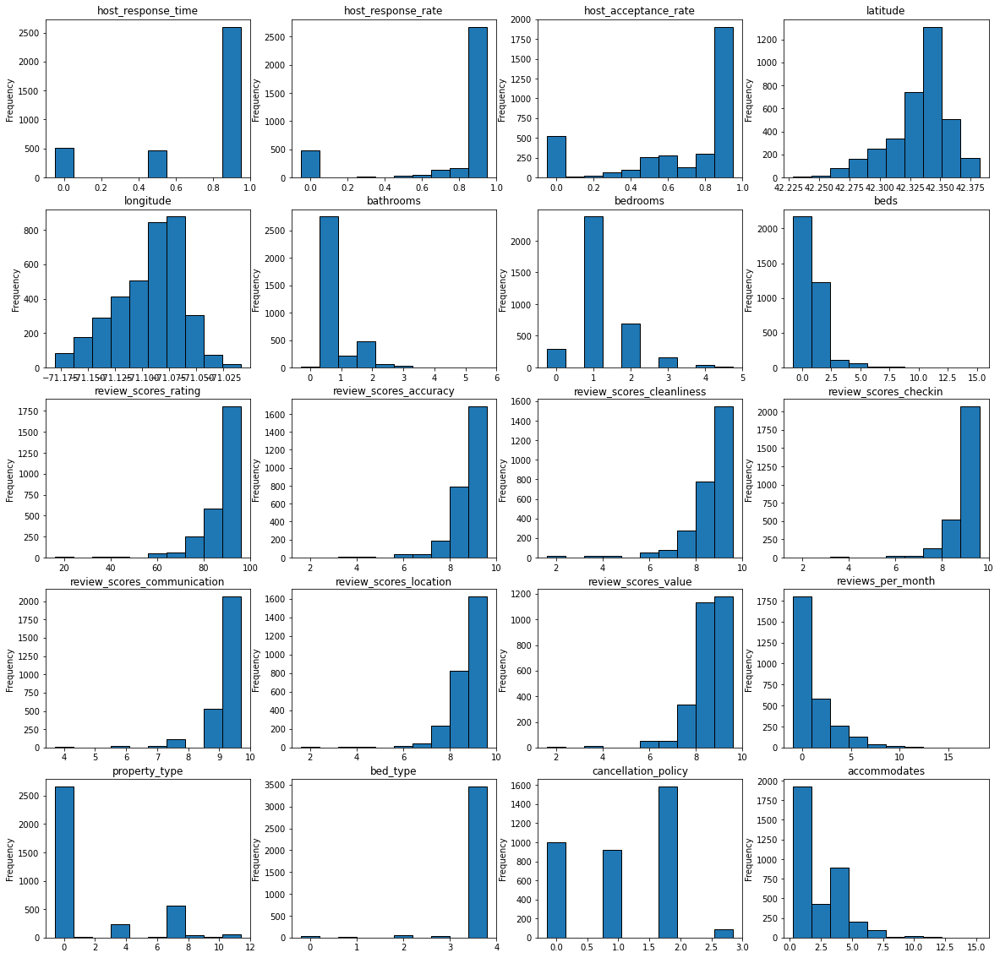

In [47]:
d=['host_response_time','host_response_rate','host_acceptance_rate','latitude','longitude','bathrooms','bedrooms','beds','review_scores_rating','review_scores_accuracy','review_scores_cleanliness','review_scores_checkin','review_scores_communication','review_scores_location','review_scores_value','reviews_per_month','property_type',	'bed_type','cancellation_policy','accommodates']
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20,20))
contador=0
for x in range(5):
    for y in range(4):
        Airbnb_dataclean[d[contador]].plot.hist(align='left',ec='black',ax=axes[x,y])
        axes[x,y].set_title(d[contador])
        contador+=1
        if contador==20: break

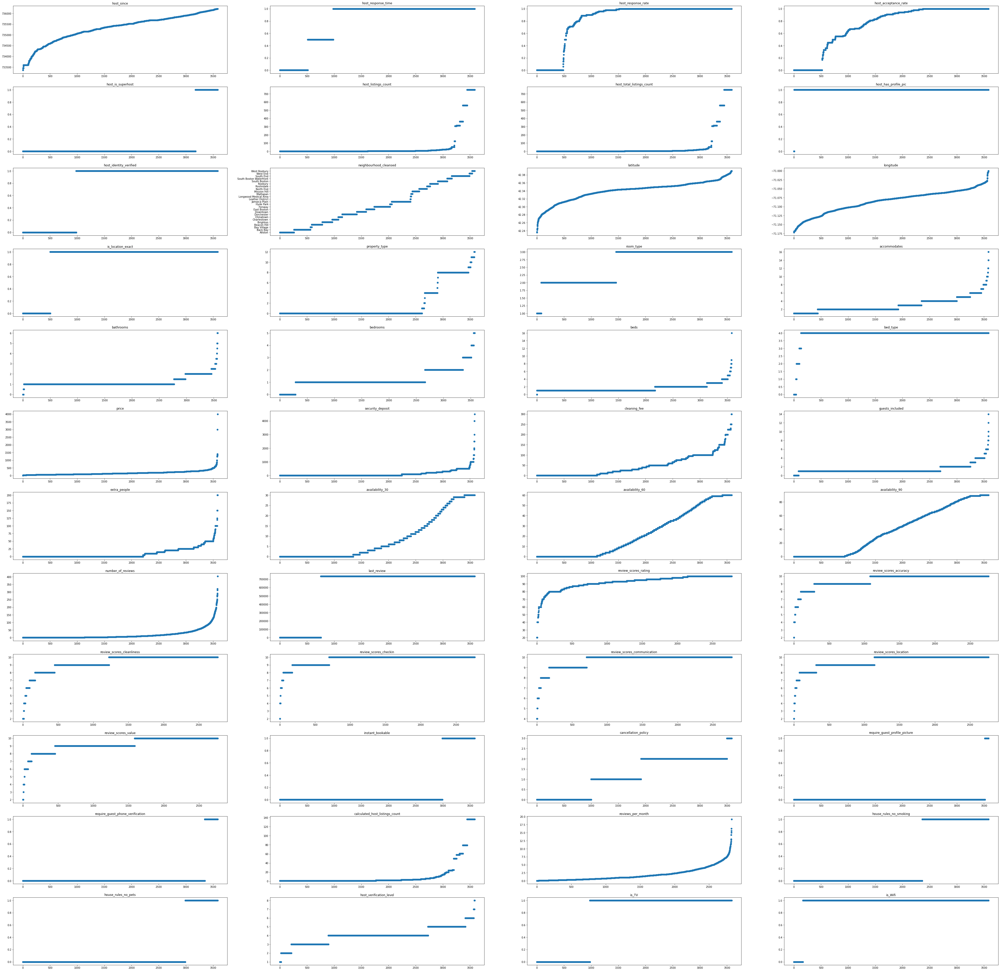

In [48]:
d=Airbnb_dataclean.dtypes.index.values

fig, axes = plt.subplots(nrows=12, ncols=4, figsize=(70,70))
contador=0
for x in range(12):
    for y in range(4):
        sorted = Airbnb_dataclean.sort_values(d[contador],ascending=True)
        ones = []
        for i in range(len(sorted[d[contador]])):
            ones.append(i)
        axes[x,y].scatter(ones,sorted[d[contador]])
        axes[x,y].set_title(d[contador])
        contador+=1
        if contador==48: break

## Analisis Bivariable

### Numericas vs Numericas
- Scatter Plot
- Heatmap
- Correlacion

<AxesSubplot:>

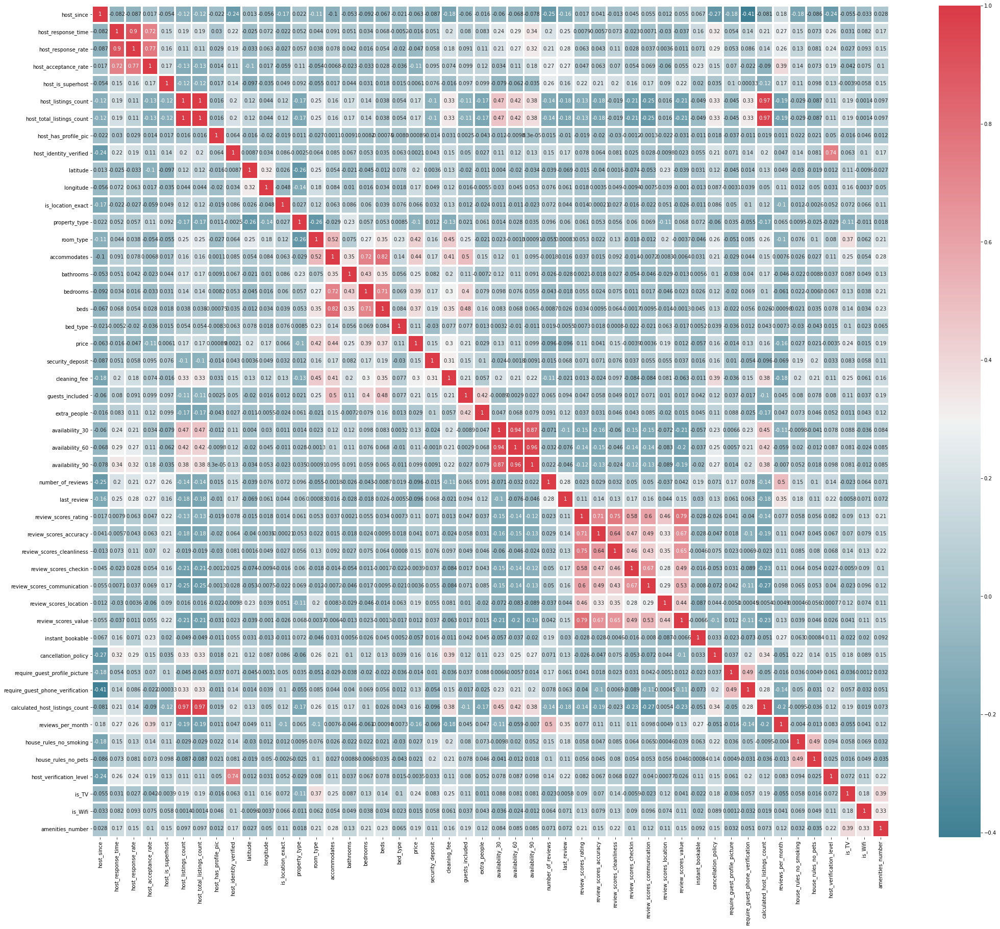

In [49]:
plt.figure(figsize=(35,30))
cmap=sns.diverging_palette(220,10,as_cmap=True)
sns.heatmap(Airbnb_dataclean.corr(),xticklabels=Airbnb_dataclean.corr().columns.values,yticklabels=Airbnb_dataclean.corr().index.values,cmap=cmap,linewidths=3,annot=True)

In [50]:
Airbnb_dataclean.isnull().sum().sort_values(ascending=False).head(20)


review_scores_accuracy         823
review_scores_location         822
review_scores_value            821
review_scores_checkin          820
review_scores_communication    818
review_scores_cleanliness      818
review_scores_rating           813
reviews_per_month              756
bathrooms                       14
bedrooms                        10
beds                             9
neighbourhood_cleansed           0
longitude                        0
host_response_time               0
host_response_rate               0
accommodates                     0
room_type                        0
property_type                    0
is_location_exact                0
latitude                         0
dtype: int64

In [51]:
Airbnb_dataclean['bedrooms'].describe()

count    3575.000000
mean        1.255944
std         0.753060
min         0.000000
25%         1.000000
50%         1.000000
75%         2.000000
max         5.000000
Name: bedrooms, dtype: float64

In [52]:
Airbnb_dataclean['calculated_host_listings_count'].describe()

count    3585.000000
mean       12.733891
std        29.415076
min         1.000000
25%         1.000000
50%         2.000000
75%         6.000000
max       136.000000
Name: calculated_host_listings_count, dtype: float64

### Análisis heat map
Por medio de este análisis de correlaciones se detectan variables con alta correlación entre sí, como por ejemplo los diferentes tipos de disponibilidad entre sí. Estas correlaciones afectan los resultados del modelo, entonces hay que elegir con qué variables nos quedaremos y cuáles borraremos.

Se eliminan:
- availability_60
- availability_90
- host_identity_verified
- review_scores_accuracy   
- review_scores_location              
- review_scores_value                 
- review_scores_checkin               
- review_scores_communication         
- review_scores_cleanliness
- host_total_listings_count
- host_response_rate
- calculated_host_listings_count           


In [53]:
Airbnb_dataclean.drop(['availability_60', 'availability_90','host_identity_verified','review_scores_accuracy','review_scores_location','review_scores_value','review_scores_checkin','review_scores_communication','review_scores_cleanliness','host_total_listings_count','host_response_rate','calculated_host_listings_count'], axis = 1,inplace=True) 

### Categoricas vs Categoricas

- Two-way table
- Graficas de Barras apiladas
- Chi-Square Test

In [54]:
 class ChiSquare:
    def __init__(self, dataframe):
        self.df = dataframe
        self.p = None #P-Value
        self.chi2 = None #Chi Test Statistic
        self.dof = None
        
        self.dfObserved = None
        self.dfExpected = None
        
    def _print_chisquare_result(self, colX, alpha):
        result = ""
        if self.p<alpha:
            result="{0} is IMPORTANT for Prediction".format(colX)
        else:
            result="{0} is NOT an important predictor. (Discard {0} from model)".format(colX)

        print(result)
        
    def TestIndependence(self,colX,colY, alpha=0.05):
        X = self.df[colX].astype(str)
        Y = self.df[colY].astype(str)
        
        self.dfObserved = pd.crosstab(Y,X) 
        chi2, p, dof, expected = stats.chi2_contingency(self.dfObserved.values)
        self.p = p
        self.chi2 = chi2
        self.dof = dof 
        
        self.dfExpected = pd.DataFrame(expected, columns=self.dfObserved.columns, index =                                                       self.dfObserved.index)
        
        self._print_chisquare_result(colX,alpha)


In [55]:
cT = ChiSquare(Airbnb_dataclean)

In [56]:
#Obtener las variables categoricas
categorical_columns=['host_has_profile_pic','neighbourhood_cleansed','host_is_superhost','is_location_exact','room_type','bed_type','cancellation_policy','require_guest_profile_picture', 'require_guest_phone_verification','house_rules_no_smoking','house_rules_no_pets']

In [57]:
for var in categorical_columns:
    cT.TestIndependence(colX=var,colY='price')

host_has_profile_pic is NOT an important predictor. (Discard host_has_profile_pic from model)
neighbourhood_cleansed is IMPORTANT for Prediction
host_is_superhost is IMPORTANT for Prediction
is_location_exact is IMPORTANT for Prediction
room_type is IMPORTANT for Prediction
bed_type is IMPORTANT for Prediction
cancellation_policy is IMPORTANT for Prediction
require_guest_profile_picture is NOT an important predictor. (Discard require_guest_profile_picture from model)
require_guest_phone_verification is IMPORTANT for Prediction
house_rules_no_smoking is IMPORTANT for Prediction
house_rules_no_pets is IMPORTANT for Prediction


In [58]:
#Se eliminan todas las variable que no son importantes
Airbnb_dataclean.drop(['host_has_profile_pic','require_guest_profile_picture'], axis = 1,inplace=True) 

In [59]:
Airbnb_dataclean.shape

(3585, 35)

## Procesamiento de Outliers
### Deteccion de Outliers (Univariables y Bi variables)
- Boxplots
- Scatter Plots
- Histogramas

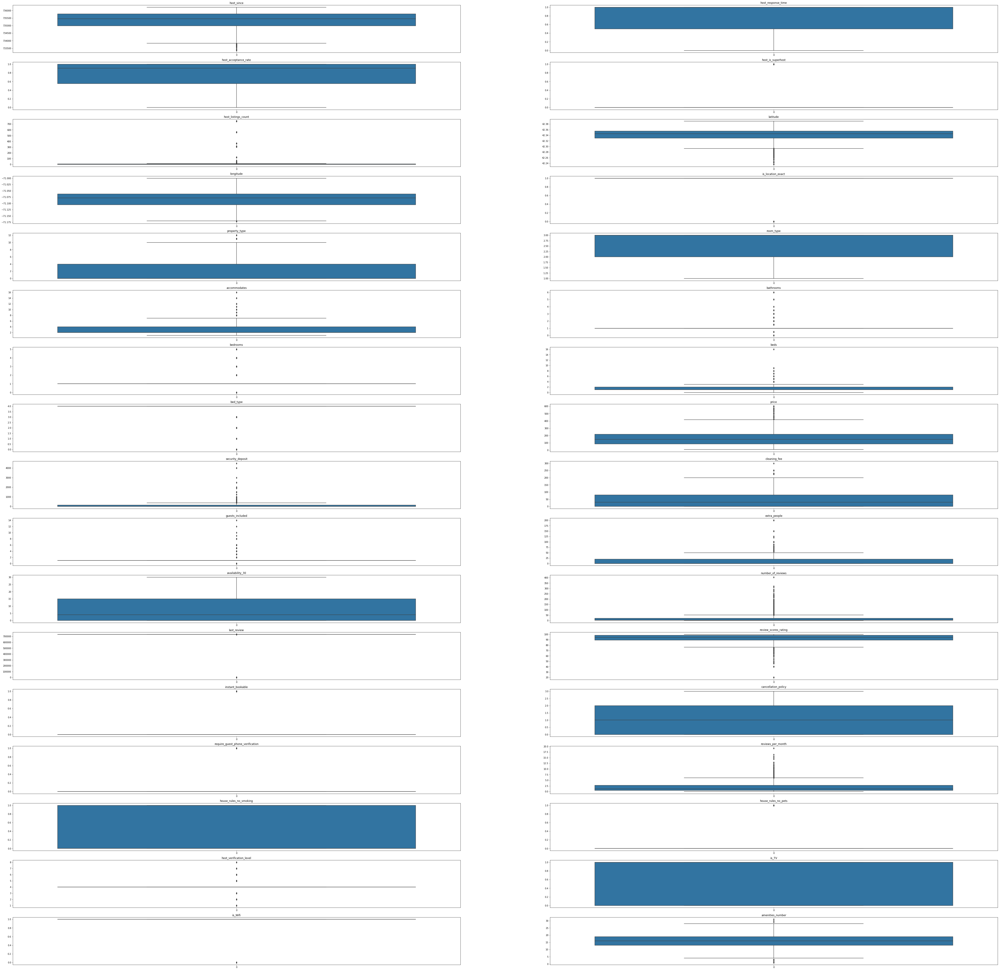

In [66]:
d=['host_since','host_response_time','host_acceptance_rate','host_is_superhost','host_listings_count','latitude','longitude','is_location_exact','property_type','room_type','accommodates','bathrooms','bedrooms','beds','bed_type','price','security_deposit','cleaning_fee','guests_included','extra_people','availability_30','number_of_reviews','last_review','review_scores_rating','instant_bookable','cancellation_policy','require_guest_phone_verification','reviews_per_month','house_rules_no_smoking','house_rules_no_pets','host_verification_level','is_TV','is_Wifi','amenities_number']

fig, axes=plt.subplots(nrows=17, ncols=2, figsize=(80,80))
contador=0
for x in range(17):
    for y in range(2):
        sns.boxplot(data=Airbnb_dataclean[d[contador]],ax=axes[x,y])
        axes[x,y].set_title(d[contador])
        contador+=1
        if contador==34: break

### Remover Outliers
las opciones son:
- Borrar los datos atipicos (outliers) 
- Transformar la variable (Ej: escalar, cambiar a esccala Log o a Escala lineal)
- Reemplazar los outliers conla Media/ Moda/ Mediana (Mean/ Mode/ Median Imputation)
- Reemplazar valores con modelo predictivo
- Separarlos y analizarlos aparte (si son muchos outliers)


Text(0.5, 1.0, 'Histograma sin Outliers')

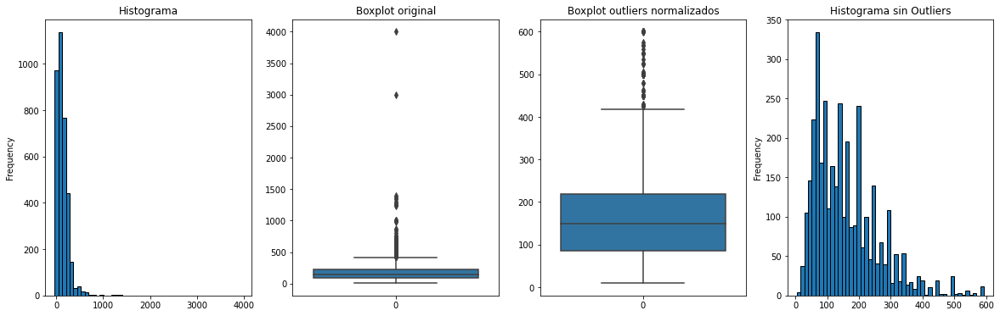

In [64]:
# En la variable price se presentan valores muy altos que, a pesar de ser reales, pueden afectar el desempeño de los modelos. Por esto se borran los registros cuyo precio es mayor a 600 dólares.

fig, axes=plt.subplots(nrows=1, ncols=4, figsize=(20, 6))
Airbnb_dataclean['price'].plot.hist(align='left',ec='black', bins=50, ax=axes[0])
sns.boxplot(data=Airbnb_dataclean['price'],ax=axes[1])

outprice=Airbnb_dataclean['price'][Airbnb_dataclean['price']>600].index.values

Airbnb_dataclean.drop(outprice,inplace=True)

sns.boxplot(data=Airbnb_dataclean['price'],ax=axes[2]); #Grafico nuevamente el boxplot para comprobar que ya no hay valores atipicos.
Airbnb_dataclean['price'].plot.hist(align='left',ec='black', bins=50, ax=axes[3])

axes[0].set_title("Histograma")
axes[1].set_title("Boxplot original")
axes[2].set_title("Boxplot outliers normalizados")
axes[3].set_title("Histograma sin Outliers")

In [65]:
Airbnb_dataclean.shape

(3547, 35)

16.0


Text(0.5, 1.0, 'Histograma sin Outliers')

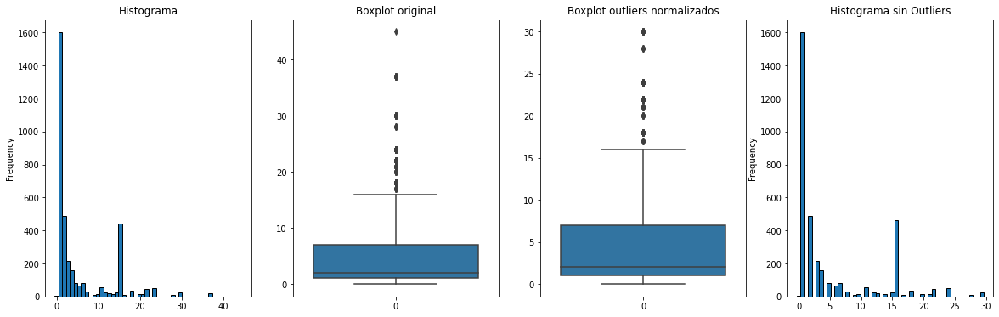

In [70]:
# En la variable host_listings_count se presentan valores muy altos que, a pesar de ser reales, pueden afectar el desempeño de los modelos. Por esto se igualan al máximo del box plot los registros cuya cantidad es mayor a 30.

fig, axes=plt.subplots(nrows=1, ncols=4, figsize=(20, 6))
Airbnb_dataclean['host_listings_count'].plot.hist(align='left',ec='black', bins=50, ax=axes[0])
sns.boxplot(data=Airbnb_dataclean['host_listings_count'],ax=axes[1])

Q1=Airbnb_dataclean['host_listings_count'].quantile(0.25);Q3=Airbnb_dataclean['host_listings_count'].quantile(0.75);IQR=Q3-Q1;MAX=Q3+1.5*IQR #Calculos de cuantiles y el máximo 
print(MAX)

outlist=Airbnb_dataclean['host_listings_count'][Airbnb_dataclean['host_listings_count']>30].index.values #Almaceno aquellas instancias que tengan valores mayores a 50

for x in range(len(outlist)):
    Airbnb_dataclean.at[outlist[x],'host_listings_count']=MAX #Reemplazo los valores extraños por el máximo


sns.boxplot(data=Airbnb_dataclean['host_listings_count'],ax=axes[2]); #Grafico nuevamente el boxplot para comprobar que ya no hay valores atipicos.
Airbnb_dataclean['host_listings_count'].plot.hist(align='left',ec='black', bins=50, ax=axes[3])

axes[0].set_title("Histograma")
axes[1].set_title("Boxplot original")
axes[2].set_title("Boxplot outliers normalizados")
axes[3].set_title("Histograma sin Outliers")


In [ ]:
# En la variable bathrooms se presentan valores muy altos que, a pesar de que pueden ser reales,afectan el desempeño de los modelos. Por esto se igualan al máximo del box plot los registros cuya cantidad es mayor a 3 baños, pues es poco común que esto ocurra

fig, axes=plt.subplots(nrows=1, ncols=4, figsize=(20, 6))
Airbnb_dataclean['host_listings_count'].plot.hist(align='left',ec='black', bins=50, ax=axes[0])
sns.boxplot(data=Airbnb_dataclean['host_listings_count'],ax=axes[1])

Q1=Airbnb_dataclean['host_listings_count'].quantile(0.25);Q3=Airbnb_dataclean['host_listings_count'].quantile(0.75);IQR=Q3-Q1;MAX=Q3+1.5*IQR #Calculos de cuantiles y el máximo 
print(MAX)

outlist=Airbnb_dataclean['host_listings_count'][Airbnb_dataclean['host_listings_count']>30].index.values #Almaceno aquellas instancias que tengan valores mayores a 50

for x in range(len(outlist)):
    Airbnb_dataclean.at[outlist[x],'host_listings_count']=MAX #Reemplazo los valores extraños por el máximo


sns.boxplot(data=Airbnb_dataclean['host_listings_count'],ax=axes[2]); #Grafico nuevamente el boxplot para comprobar que ya no hay valores atipicos.
Airbnb_dataclean['host_listings_count'].plot.hist(align='left',ec='black', bins=50, ax=axes[3])

axes[0].set_title("Histograma")
axes[1].set_title("Boxplot original")
axes[2].set_title("Boxplot outliers normalizados")
axes[3].set_title("Histograma sin Outliers")

## Preparacion de Datos Faltantes
Las opciones que se pueden usar dependiendo del analisis de los datos son:
### Borrar Filas
- Borrar las filas que les falten todos los datos
- Borrar Solo las filas que les falta las variables mas importantes o la salida

In [80]:
#Se verifican todas las instancias que tienen más del 33.33% de los datos faltantes (12 datos en adelante)

missing=Airbnb_dataclean.isnull().sum(axis=1)[Airbnb_dataclean.isnull().sum(axis=1)>11]

missing

Series([], dtype: int64)

### Reemplazar datos faltantes con la Media/ Moda/ Mediana (Mean/ Mode/ Median Imputation)

## Remover Datos Duplicados

Hacer al principio luego de cargar los datos y luego de Hacer imputaciones o eliminacion de columnas.

## Feature Engineering 
### Transformacion de Variables
**Se usa cuando es necesario:**
- Cambiar la escala las variables (Normalizar, escalamiento, etc), esto no cambia la forma de la distribucion de los datos
- Cambiar relaciones No ineales en Lineales (Ej: cambiar la escala Logaritmica a lineal)
- Usar una la distribución simétrica en vez de una distribución sesgada o asimetrica, Para una la distribución sesgada a la derecha, tomamos la raíz cuadrada / cúbica o el logaritmo de la variable, y para la desviación a la izquierda, tomamos el cuadrado / cubo o exponencial de las variables.
- Cambair variables continuas a categoricas

Los tipos de transformacion son:

#### Normalizacion

#### Escalamiento

#### Logaritmica

#### raíz cuadrada / cúbica

#### Binning , Cambios de Numericas a Categoricas

## Analisis Univariable y Bivariable Final
Luego de Realizar:
- Tratamiento de datos Nulos
- Tratamiento de outliers
- Transformacion de Variables

Es necesario realizar nuevamente analisis univarible y bivariable para identificar como cambiaron nuestros datos y para verificar si estan listos para usarse para crear un modelo.

### Creacion de Variables
pueden ser:
#### Crear Variables derivadas de Otras

## Reduccion de Dimensionalidad y Seleccion de Variables (PCA)

De ser necesario si tiene muchas variables o sospecha que aun tiene variables que no aportan mucho

## Balance de datos

Se realiza para problemas de clasificacion, solo si es necesario.

# MODELAMIENTO DE LOS DATOS (MACHINE LEARNING)


## Dividir el dataset en Training set y Test set

Este paso debe ser al inicio de los proyectos, pero para realizarlo de esa forma se debe automatizar todas las transformaciones, preparación de datos y limpieza de los datos, para aplicarlos al test set y a ls datos nuevos que lleguen al sistema.

por este motivo se realizara en esta parte.

# Validacion y Evaluacion Cruzada (k-fold Cross Validation)

Entrenar los algoritmos Usando el Training Set

# Optimizacion de Hiper parametros (Hyper Parameter optimization)

Se seleccionan alguno modelos para realziar eset paso, ya que tiene una carga computacional alta.

# Prueba final del modelo con el Test set

# Conclusiones

# Ayudas Y Referencias

- https://medium.com/@joserzapata/paso-a-paso-en-un-proyecto-machine-learning-bcdd0939d387
- [a-complete-machine-learning-walk-through-in-python-part-one](https://towardsdatascience.com/a-complete-machine-learning-walk-through-in-python-part-one-c62152f39420)

- [a-starter-pack-to-exploratory-data-analysis-with-python-pandas-seaborn-and-scikit-learn](https://towardsdatascience.com/a-starter-pack-to-exploratory-data-analysis-with-python-pandas-seaborn-and-scikit-learn-a77889485baf#249d)

- [a-data-science-for-good-machine-learning-project-walk-through-in-python-part-one](https://towardsdatascience.com/a-data-science-for-good-machine-learning-project-walk-through-in-python-part-one-1977dd701dbc)

- [Ejemplos de Kaggle](https://www.kaggle.com/kernels?sortBy=hotness&group=everyone&pageSize=20&language=Python&kernelType=Notebook)

- [END to END ML from data colletion to deployment](https://medium.com/datadriveninvestor/end-to-end-machine-learning-from-data-collection-to-deployment-ce74f51ca203)

Docente: [Jose R. Zapata](https://joserzapata.github.io)
- https://joserzapata.github.io
- https://twitter.com/joserzapata
- https://www.linkedin.com/in/jose-ricardo-zapata-gonzalez/   